# CFD Solver: OOP 


## Necessary Packages and Useful Functions

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
%matplotlib inline
import sys
import seaborn as sns

In [ ]:
def diff_1st_x(f, dx):
    return (f[1:-1, 2:] - f[1:-1,0:-2])/(2*dx)

def diff_1st_y(f, dy):
    return (f[2:, 1:-1] - f[0:-2,1:-1])/(2*dy)

def diff_2nd_x(f, dx):
    return (
        # f(i-1,j) + 2*f(i,j) + f(i+1,j) 
        (f[1:-1,0:-2] - 2*f[1:-1,1:-1] + f[1:-1,2:])
        /dx**2
        ) 

def diff_2nd_y(f, dy):
    return (
        # f(i,j-1) + 2*f(i,j) + f(i,j+1) 
        (f[0:-2,1:-1] - 2*f[1:-1,1:-1] + f[2:,1:-1])
        /dy**2
        )

def laplacian(f, dx, dy):
    return (diff_2nd_x(f, dx) + 
            diff_2nd_y(f, dy))
    


## Object-Oriented Programming

In [ ]:
class CFD:

    def __init__(self, nx = 41, ny = 41, x_max = 2, x_min = 0,
             y_max = 2, y_min = 0, nt = 500):
        
        self.nx = nx
        self.x_max = x_max 
        self.x_min = x_min

        self.ny = ny
        self.y_max = y_max
        self.y_min = y_min

        self.nt = nt
        self.dx = (self.x_max - self.x_min) / (self.nx - 1)
        self.dy = (self.y_max - self.y_min) / (self.ny - 1)

        self.x = np.linspace(self.x_min, self.x_max, self.nx)
        self.y = np.linspace(self.y_min, self.y_max, self.ny)
        self.X, self.Y = np.meshgrid(self.x,self.y)

    def initialize(self, rho = 1, nu = 0.1, dt = 0.001, u_lid = 1,
                   system = 'one_lid_cavity'):
        # initial condition
        self.rho = rho # density
        self.nu = nu # kinetic viscosity = viscosity/density
        self.dt = dt # timestep
        self.u_lid = u_lid
        self.system = system

        self.u = np.zeros((self.ny, self.nx))
        self.v = np.zeros((self.ny, self.nx))
        self.p = np.zeros((self.ny, self.nx))
        self.time = 0

    def set_velocity_boundary(self, u, v):
        
        # Velocidty boundary conditions (Dirichlet or "fixed")
        u[0, :]  = 0
        u[:, 0]  = 0
        u[:, -1] = 0
        
        v[0, :]  = 0
        v[-1, :] = 0
        v[:, 0]  = 0
        if self.system == 'one_lid_cavity':
            v[:, -1] = 0
        elif self.system == 'two_lid_cavity':
            v[:, -1] = self.u_lid

        u[-1, :] = self.u_lid   # set velocity on cavity lid

        return u,v

    def set_pressure_boundary(self, p):
        # Pressure boundary conditions (Neumann or "second-type")
        p[0, :] = p[1, :]   # dp/dy = 0 at y = 0
        p[:, 0] = p[:, 1]   # dp/dx = 0 at x = 0
        
        # Pressure boundary conditions (Dirichlet or "fixed")
        p[-1, :] = 0        # p = 0 at y = 2

        if self.system == 'one_lid_cavity':
            p[:, -1] = p[:, -2] # dp/dx = 0 at x = 2
        elif self.system == 'two_lid_cavity':
            p[:, -1] = 0        # p = 0 at x = 2

        return p

    def compute_vel_star(self):
        un, vn, dx, dy, dt = self.un, self.vn, self.dx, self.dy, self.dt
        
        u_star = un.copy()
        v_star = vn.copy()

        # Equation (7), Owkes (2020)
        u_star[1:-1,1:-1] = (self.nu * laplacian(un, dx, dy) -
                                (un[1:-1, 1:-1]*diff_1st_x(un,dx) + 
                                vn[1:-1, 1:-1]*diff_1st_y(un,dy))
                            )*dt + un[1:-1, 1:-1]
                            
        # Equation (12), Owkes (2020)
        v_star[1:-1,1:-1] = (self.nu * laplacian(vn, dx, dy) -
                                (un[1:-1, 1:-1]*diff_1st_x(vn,dx) + 
                                vn[1:-1, 1:-1]*diff_1st_y(vn,dy))
                            )*dt + vn[1:-1, 1:-1]
        
        return u_star, v_star

    def get_b(self):
        '''
        Right hand side of equation (6), Owkes (2020)
        '''

        u_star, v_star = self.u_star, self.v_star
        dx, dy, dt = self.dx, self.dy, self.dt
        
        # (Divergence of vector-valued function)
        divergence_vel_star = (diff_1st_x(u_star,dx) + 
                                diff_1st_y(v_star,dy))
        # b[1:-1,1:-1] = (1*rho/dt) * divergence_vel_star
        b = (self.rho/dt) * divergence_vel_star

        return b

    def pressure_poisson(self):  
        p, b, dx, dy = self.p, self.b, self.dx, self.dy

        pn = p.copy()

        # (pn(i-1,j) + pn(i+1,j)) * dy**2 
        term1 = (pn[1:-1,0:-2] + pn[1:-1,2:]) * dy**2
        # (pn(i,j-1) + pn(i,j+1)) * dx**2
        term2 = (pn[0:-2,1:-1] + pn[2:,1:-1]) * dx**2
        # term 3 is -b * dx^2  * dy^2
        term3 = -(b * (dx**2 * dy**2))

        p[1:-1,1:-1] = (
            (term1 + term2 + term3)
            / (2*(dx**2+dy**2))
        )

        p = self.set_pressure_boundary(p)

        return p

    def corrector_step(self):
        u_star, v_star, p = self.u_star, self.v_star, self.p 
        dx, dy, dt, rho = self.dx, self.dy, self.dt, self.rho
        
        u = np.empty_like(u_star)
        v = np.empty_like(u_star)

        u[1:-1,1:-1] = (-dt/rho)*(diff_1st_x(p, dx)) + u_star[1:-1,1:-1]
        v[1:-1,1:-1] = (-dt/rho)*(diff_1st_y(p, dy)) + v_star[1:-1,1:-1]

        u,v = self.set_velocity_boundary(u, v)

        return u, v

    def update_cavity_flow(self, nt = 200):

        for n in range(nt):
            self.un = self.u.copy()
            self.vn = self.v.copy()

            # Predictor step (starred velocities)
            self.u_star, self.v_star = self.compute_vel_star()

            # Solve pressure Poisson Equation
            self.b = self.get_b()
            self.p = self.pressure_poisson()

            # Corrector step (update velocities)
            self.u, self.v = self.corrector_step()

            self.time += self.dt


    def display(self):
        plt.figure(figsize =(9,6))
        # plotting the Pressure as a contour
        plt.contourf(self.X, self.Y, self.p, alpha=0.5, cmap=cm.viridis)
        plt.colorbar(label = 'Pressure, p')
        # plotting the Pressure velocity outlines
        plt.contour(self.X, self.Y, self.p, cmap=cm.viridis)
        # plotting streamplot
        plt.streamplot(self.X, self.Y, self.u, self.v)  
        # plotting velocity field
        plt.quiver(self.X[::2, ::2], self.Y[::2, ::2], 
                   self.u[::2, ::2], self.v[::2, ::2])
        plt.xlabel('X')
        plt.ylabel('Y');
        plt.title(f'$u (lid) =$ {self.u_lid}, $\\nu =$ {self.nu}, time = {np.round(self.time, 3)}')
        plt.show()

    def display_centerline_plot(self):
        x = self.y/self.y_max # central vertical line
        y = self.u[:, int(self.nx/2)] / self.u_lid
        plt.plot(x,y)
        plt.xlabel('Relative Position along the central vertical line, $y/y_{max}$')
        plt.ylabel('Relative Horizontal Velocity, $u / u_{lid}$')
        plt.grid()
        plt.title(f'$u (lid) =$ {self.u_lid}, $\\nu =$ {self.nu}, time = {np.round(self.time, 3)}')
        plt.show()

# One Lid Cavity

## Test Case

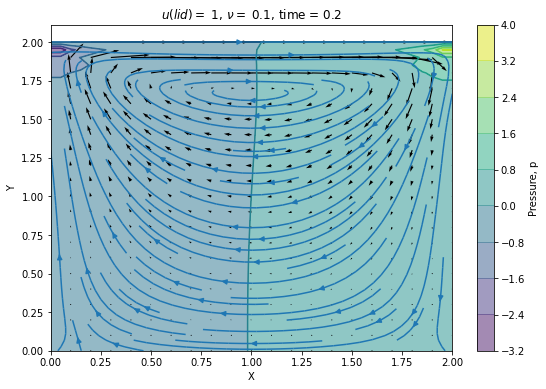

In [ ]:
cavity_flow = CFD()
cavity_flow.initialize()
#cavity_flow.display()

cavity_flow.update_cavity_flow()
cavity_flow.display()


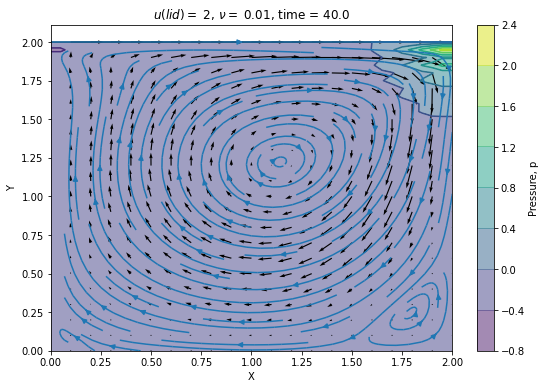

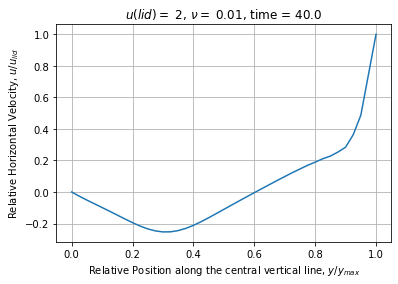

In [ ]:
cavity_flow = CFD()
cavity_flow.initialize(u_lid = 2, nu = 0.01)
#cavity_flow.display()


cavity_flow.update_cavity_flow(nt=100*300)
cavity_flow.display()
cavity_flow.display_centerline_plot()


## Animation: Centerline Velocity

In [ ]:
# Benchmark value for Re=400 from Ghia et al (1982)
ghia_benchmark = np.array([(1.0000, 1.00000),  
                        (0.9766, 0.75837),  
                        (0.9688, 0.68439),  
                        (0.9609, 0.61756),  
                        (0.9531, 0.55892),  
                        (0.8516, 0.29093),  
                        (0.7344, 0.16256),  
                        (0.6172, 0.02135),  
                        (0.5000, -0.11477), 
                        (0.4531, -0.17119), 
                        (0.2813, -0.32726), 
                        (0.1719, -0.24299), 
                        (0.1016, -0.14612), 
                        (0.0703, -0.10338),
                        (0.0625, -0.09266), 
                        (0.0547, -0.08186), 
                        (0.0000, 0.00000)])

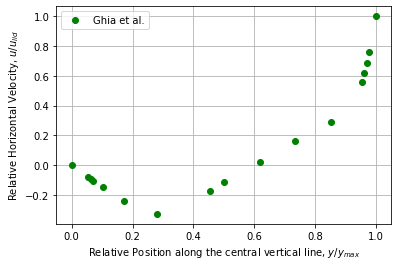

In [ ]:
plt.plot(ghia_benchmark[:,0], ghia_benchmark[:, 1], 'o', color='green', 
         label = 'Ghia et al.')
plt.legend()
plt.xlabel('Relative Position along the central vertical line, $y/y_{max}$')
plt.ylabel('Relative Horizontal Velocity, $u / u_{lid}$')
plt.grid()
plt.show()

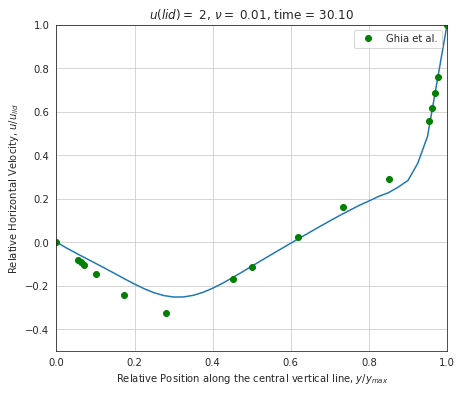

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

### Animation ###

cavity_flow = CFD()
cavity_flow.initialize(u_lid = 2, nu = 0.01)

# create figure, axis, and lines for drawing
lines  = [None, None]
fig    = plt.figure(figsize =(7,6))
ax     = plt.subplot(xlim = (0, 1), ylim = (-0.5, 1))

# initialize lines to certain values
x = cavity_flow.y/cavity_flow.y_max # vertical line
y = cavity_flow.u[:, int(cavity_flow.nx/2)] / cavity_flow.u_lid
lines[0], = ax.plot(x,y)  
plt.plot(ghia_benchmark[:,0], ghia_benchmark[:, 1], 'o', color='green', 
         label = 'Ghia et al.')
plt.legend()
ax.set_xlabel('Relative Position along the central vertical line, $y/y_{max}$')
ax.set_ylabel('Relative Horizontal Velocity, $u / u_{lid}$')
ax.grid()
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=100)
    x = cavity_flow.y/cavity_flow.y_max # vertical line
    y = cavity_flow.u[:, int(cavity_flow.nx/2)] / cavity_flow.u_lid
    lines[0].set_data(x, y)
    #lines[1].set_data([0, sys.pos[0]], [0, sys.pos[1]])
    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
    return lines
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 300), interval = 100)
HTML(ani.to_html5_video())


We can see that the centerline plot becomes pretty close to the benchmark results over time.

## Animation: Streamplot

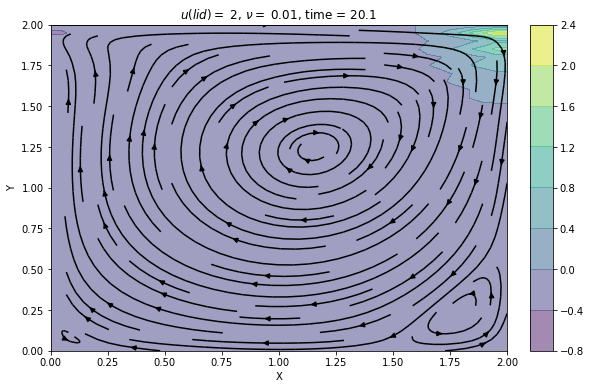

In [ ]:
### Animation ###

cavity_flow = CFD()
cavity_flow.initialize(u_lid = 2, nu = 0.01)

# create figure, axis, and lines for drawing
#lines  = [None, None]
fig    = plt.figure(figsize =(9,6))
ax     = plt.subplot(xlim = (cavity_flow.x_min, cavity_flow.x_max), 
                     ylim = (cavity_flow.y_min, cavity_flow.y_max))

# colorbar axis
div = make_axes_locatable(ax)
cax = div.append_axes('right', '5%', '5%')

# initialize lines to certain values
cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
cb = fig.colorbar(cf, cax=cax, label = 'Pressure. p')

# plotting streamplot
stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  
# plotting the Pressure velocity outlines
#ax.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)

# plotting velocity field
#ax.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
#            cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
ax.set_xlabel('X')
ax.set_ylabel('Y');
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=100)

    ax.collections = [] # clear lines streamplot
    ax.patches = [] # clear arrowheads streamplot
    
    cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
    cax.cla()
    fig.colorbar(cf, cax=cax)

    # plotting streamplot
    stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

    #lines[1].set_data([0, sys.pos[0]], [0, sys.pos[1]])
    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')
    return [cf, stream]
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 200), interval = 150)
HTML(ani.to_html5_video())


## Changing Parameters

### Changing Kinetic Viscosity

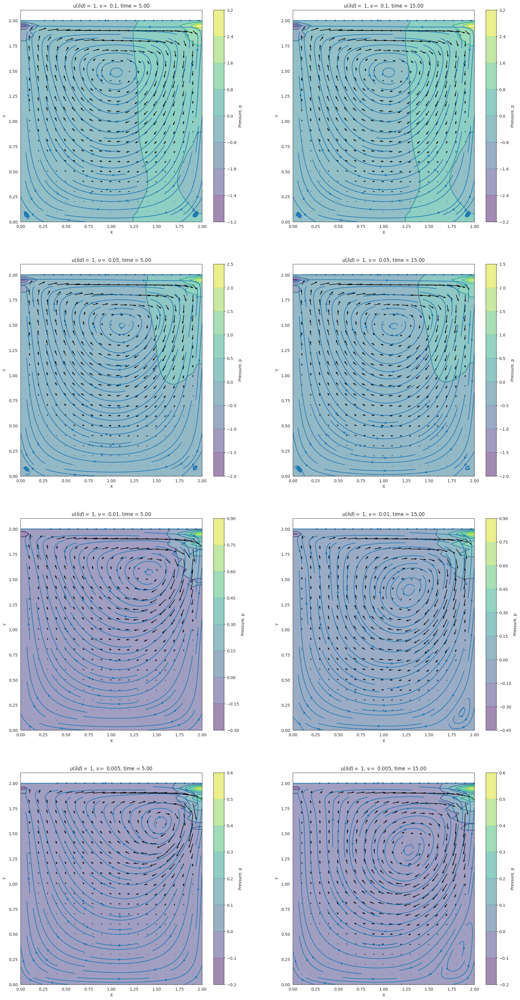

In [ ]:
fig = plt.figure(figsize=(22,44), dpi=100)

nus = [0.1, 0.05, 0.01, 0.005] # add your value here

cavity_flow = CFD()

for i in range(len(nus)):
    cavity_flow.initialize(u_lid = 1, nu = nus[i])

    cavity_flow.update_cavity_flow(nt=100*50)

    plt.subplot(4,2,2*i+1)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')

    cavity_flow.update_cavity_flow(nt=100*100)

    plt.subplot(4,2,2*i+2)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
plt.show()

Here in the first column we plotted the system at time, t = 5 to check its intermediate state and in the second column we plotted the system at t= 15, when the system will most likely become stable.

We can see that initially (at t = 5), the central vortex is moving towards the top right corner as the kinetic viscosity decreases. One possible reason could be that due to low viscosity, now the fluid can make turning with a smaller angle. This is somewhat analogous to the example of a rope vs a chain of bead. As the rope segments are tightly joint, they cannot bend at a smaller angle unlike a chain of bead. Here when the fluid is more viscocious, it drags more fluid  from below and make a longer turning path.

Also as the high viscosity water makes sharper turn, the fluid in the lower corner become isolated and create a corner vortex. The higher the viscosity, the longer the corner vortex is. 

Also note that for higher viscosity, the high pressure region is also moving towards top right corner and the maximum pressure value is decreasing. 

### Changing Lid Velocity

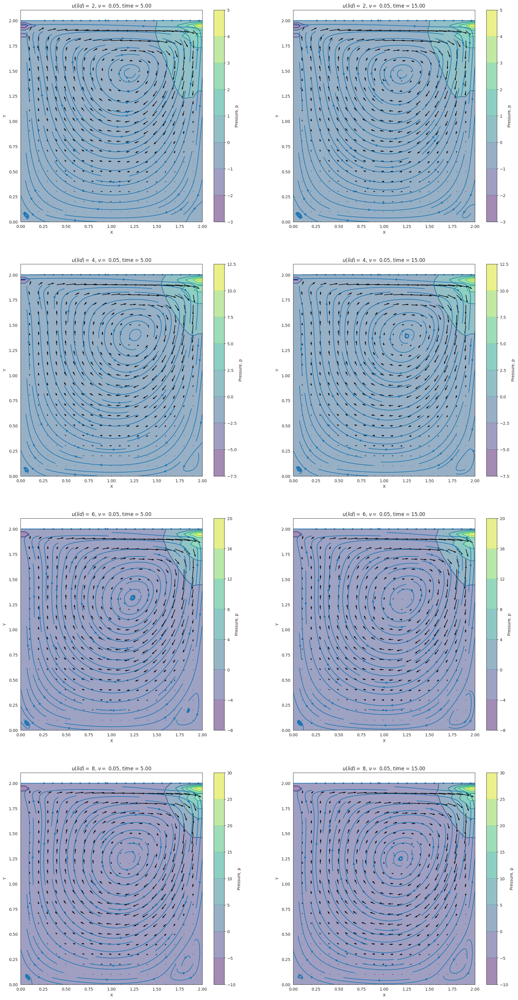

In [ ]:
fig = plt.figure(figsize=(22,44), dpi=100)

u_lids = [2,4,6,8] # add your value here

cavity_flow = CFD()

for i in range(len(u_lids)):
    cavity_flow.initialize(u_lid = u_lids[i], nu = 0.05)

    cavity_flow.update_cavity_flow(nt=100*50)

    plt.subplot(4,2,2*i+1)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')

    cavity_flow.update_cavity_flow(nt=100*100)

    plt.subplot(4,2,2*i+2)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
plt.show()

Similar to what we saw for varying viscosity, here also the bottom corner vortices are created and becoming larger for larger lid velocity.

Also the high and low pressure regions are moving towards top-right and top-left corner respectively for higher velocity.

But the maximum pressure value is increasing and minimum pressure value is decreasing for higher velocity. A large difference in pressure means the fluid flow will increase in that region. So for higher velocity the flow is increasing in the system.

### Changing Re Values

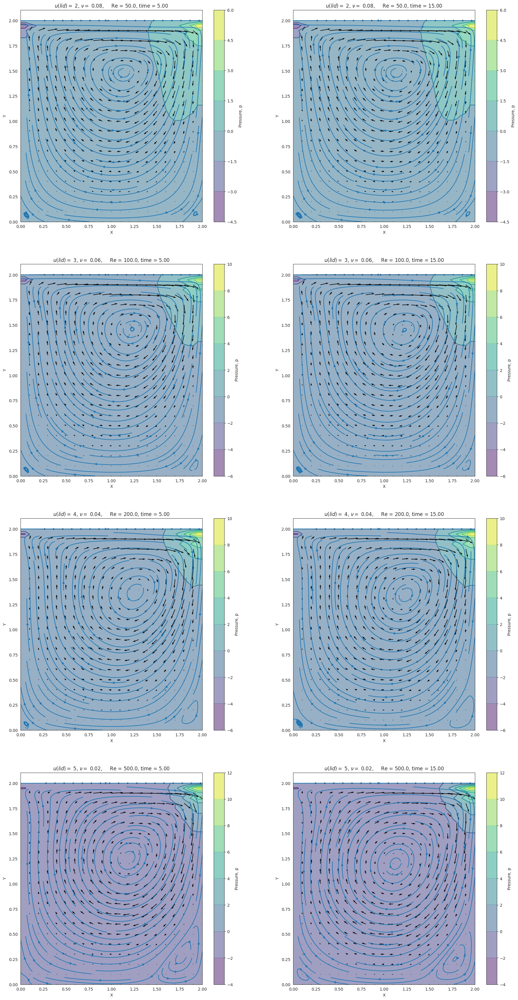

In [ ]:
fig = plt.figure(figsize=(22,44), dpi=100)

nus = [0.08, 0.06, 0.04, 0.02] 
u_lids = [2,3,4,5] 

cavity_flow = CFD()

for i in range(len(u_lids)):
    cavity_flow.initialize(u_lid = u_lids[i], nu = nus[i])

    cavity_flow.update_cavity_flow(nt=100*50)

    plt.subplot(4,2,2*i+1)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, \
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')

    cavity_flow.update_cavity_flow(nt=100*100)

    plt.subplot(4,2,2*i+2)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
plt.show()

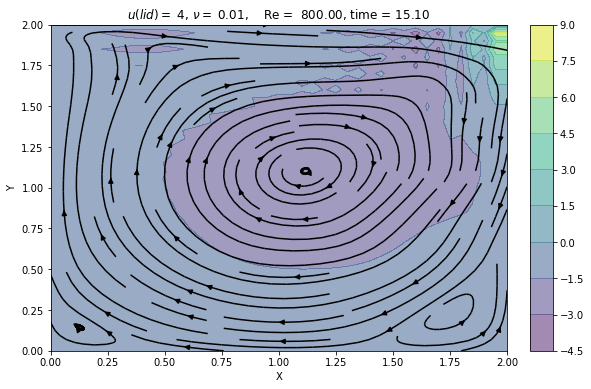

In [ ]:

### Animation ###

cavity_flow = CFD()

u_lid = 4
Re = np.array([200, 400, 600, 800])
nus = 2*u_lid / Re

cavity_flow.initialize(u_lid = u_lid, nu = nus[3])

# create figure, axis, and lines for drawing
fig    = plt.figure(figsize =(9,6))
ax     = plt.subplot(xlim = (cavity_flow.x_min, cavity_flow.x_max), 
                    ylim = (cavity_flow.y_min, cavity_flow.y_max))

# colorbar axis
div = make_axes_locatable(ax)
cax = div.append_axes('right', '5%', '5%')

# initialize lines to certain values
cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
cb = fig.colorbar(cf, cax=cax, label = 'Pressure. p')

# plotting streamplot
stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

ax.set_xlabel('X')
ax.set_ylabel('Y');
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=100)

    ax.collections = [] # clear lines streamplot
    ax.patches = [] # clear arrowheads streamplot
    
    cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
    cax.cla()
    fig.colorbar(cf, cax=cax)

    # plotting streamplot
    stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu: 0.2f}, time = {cavity_flow.time:0.2f}')
    return [cf, stream]
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 150), interval = 200)
HTML(ani.to_html5_video())

Now we will consider the changes together. We also make streamline animation for different value of Re.

As discussed earlier, for higher value of Re, we are getting larger corner votices in the bottom.

The absolute value of maximum and minimum pressure is slightly increasing for higher Re value.

But from the streamplot animations, we can see that for higher values, it takes a bit longer for the system to become a steady state (i.e. having a steady flow). For example for Re=800, we can see that the flow and the pressure region both are changing arbitarily. Also for high Re value, we can see that some additional pressure region is created at the bottom (i.e. for Re=600).

So overall for low Re, the system is more steady and for high Re, it is more turbulant.

# Two-Lid cavity

## Test Case

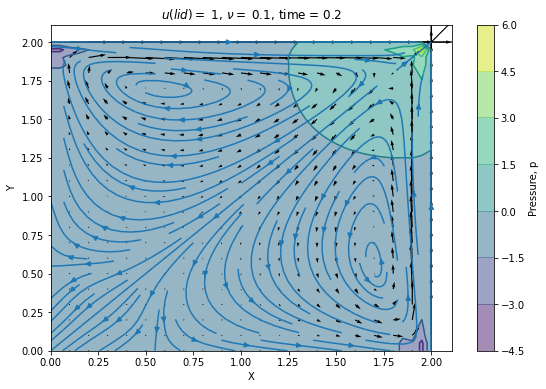

In [ ]:
cavity_flow = CFD()
cavity_flow.initialize(system = 'two_lid_cavity')
#cavity_flow.display()

cavity_flow.update_cavity_flow()
cavity_flow.display()


## Animation

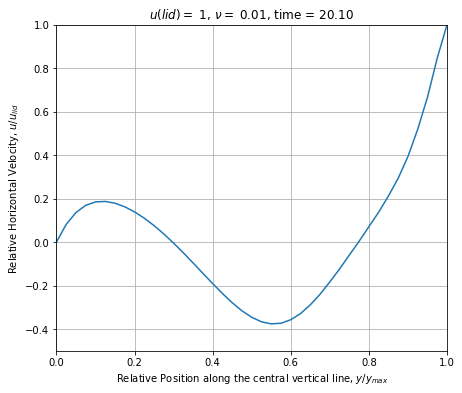

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

### Animation ###

cavity_flow = CFD()
cavity_flow.initialize(u_lid = 1, nu = 0.01, system = 'two_lid_cavity')

# create figure, axis, and lines for drawing
lines  = [None, None]
fig    = plt.figure(figsize =(7,6))
ax     = plt.subplot(xlim = (0, 1), ylim = (-0.5, 1))

# initialize lines to certain values
x = cavity_flow.y/cavity_flow.y_max # vertical line
y = cavity_flow.u[:, int(cavity_flow.nx/2)] / cavity_flow.u_lid
lines[0], = ax.plot(x,y)  
ax.set_xlabel('Relative Position along the central vertical line, $y/y_{max}$')
ax.set_ylabel('Relative Horizontal Velocity, $u / u_{lid}$')
ax.grid()
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=100)
    x = cavity_flow.y/cavity_flow.y_max # vertical line
    y = cavity_flow.u[:, int(cavity_flow.nx/2)] / cavity_flow.u_lid
    lines[0].set_data(x, y)
    #lines[1].set_data([0, sys.pos[0]], [0, sys.pos[1]])
    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
    return lines
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 200), interval = 100)
HTML(ani.to_html5_video())


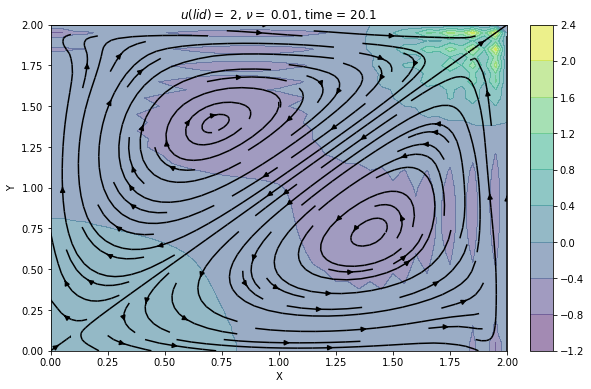

In [ ]:
### Animation ###

cavity_flow = CFD()
cavity_flow.initialize(u_lid = 2, nu = 0.01, system = 'two_lid_cavity')

# create figure, axis, and lines for drawing
#lines  = [None, None]
fig    = plt.figure(figsize =(9,6))
ax     = plt.subplot(xlim = (cavity_flow.x_min, cavity_flow.x_max), 
                     ylim = (cavity_flow.y_min, cavity_flow.y_max))

# colorbar axis
div = make_axes_locatable(ax)
cax = div.append_axes('right', '5%', '5%')

# initialize lines to certain values
cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
cb = fig.colorbar(cf, cax=cax, label = 'Pressure. p')

# plotting streamplot
stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

ax.set_xlabel('X')
ax.set_ylabel('Y');
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=100)

    ax.collections = [] # clear lines streamplot
    ax.patches = [] # clear arrowheads streamplot
    
    cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
    cax.cla()
    fig.colorbar(cf, cax=cax)

    # plotting streamplot
    stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, time = {np.round(cavity_flow.time, 3)}')
    return [cf, stream]
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 200), interval = 150)
HTML(ani.to_html5_video())


## Changing Re Values

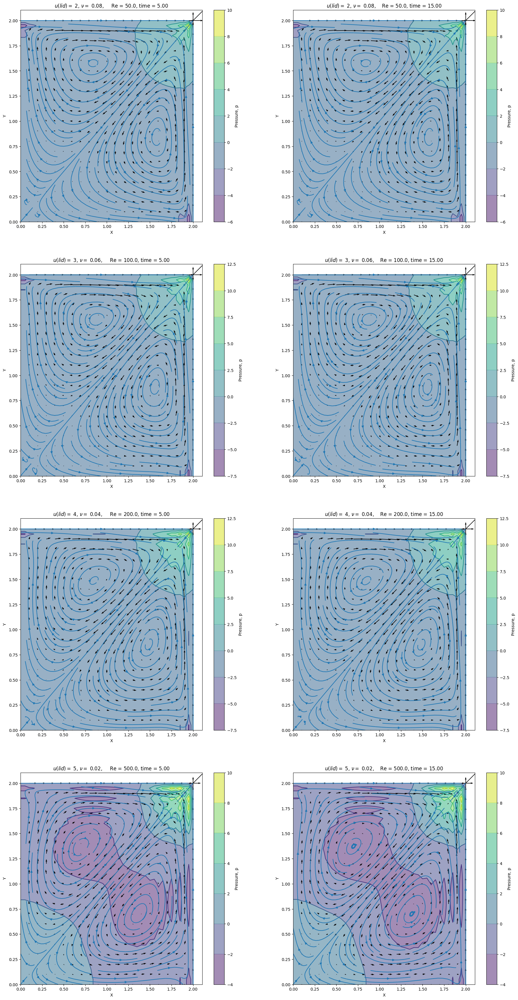

In [ ]:
fig = plt.figure(figsize=(22,44), dpi=100)

nus = [0.08, 0.06, 0.04, 0.02] 
u_lids = [2,3,4,5] 

cavity_flow = CFD()

for i in range(len(u_lids)):
    cavity_flow.initialize(u_lid = u_lids[i], nu = nus[i], system = 'two_lid_cavity')

    cavity_flow.update_cavity_flow(nt=100*50)

    plt.subplot(4,2,2*i+1)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu}, \
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')

    cavity_flow.update_cavity_flow(nt=100*100)

    plt.subplot(4,2,2*i+2)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in add
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:84: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:85: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in add
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in subtract
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in subtract
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:100: Runti

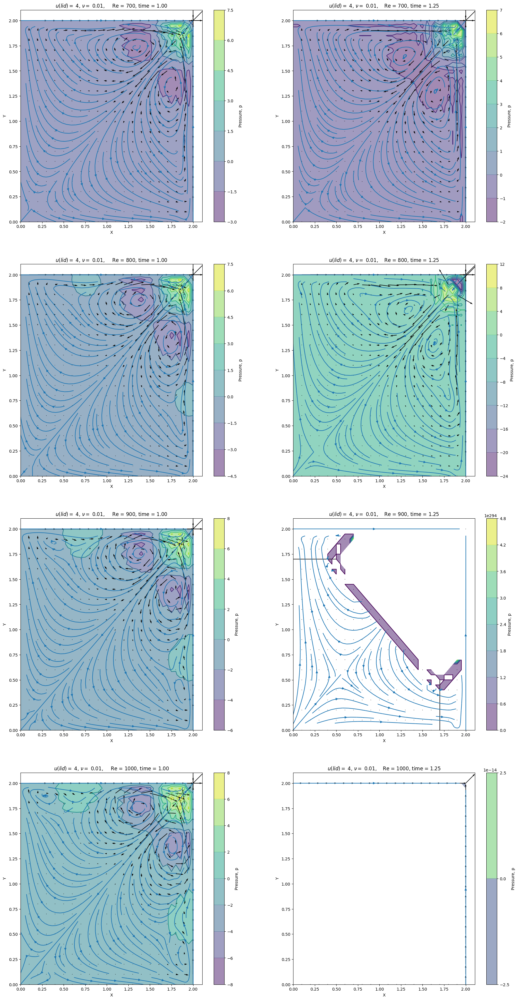

In [ ]:
fig = plt.figure(figsize=(22,44), dpi=100)

u_lid = 4
Re = np.array([700, 800, 900, 1000])
nus = 2*u_lid / Re

cavity_flow = CFD()

for i in range(len(u_lids)):
    cavity_flow.initialize(u_lid = u_lid, nu = nus[i], system = 'two_lid_cavity')

    cavity_flow.update_cavity_flow(nt=50*20)

    plt.subplot(4,2,2*i+1)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f}, \
    Re = {Re[i]}, time = {cavity_flow.time:0.2f}')

    cavity_flow.update_cavity_flow(nt=50*5)

    plt.subplot(4,2,2*i+2)
    
    # plotting the Pressure as a contour
    plt.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5, cmap=cm.viridis)
    plt.colorbar(label = 'Pressure, p')
    # plotting the Pressure velocity outlines
    plt.contour(cavity_flow.X, cavity_flow.Y, cavity_flow.p, cmap=cm.viridis)
    # plotting streamplot
    plt.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v)  
    # plotting velocity field
    plt.quiver(cavity_flow.X[::2, ::2], cavity_flow.Y[::2, ::2], 
                cavity_flow.u[::2, ::2], cavity_flow.v[::2, ::2])
    plt.xlabel('X')
    plt.ylabel('Y');
    plt.title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f},\
    Re = {Re[i]}, time = {cavity_flow.time:0.2f}')
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in add
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:84: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:85: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in add
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in subtract
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in subtract
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:100: Runti

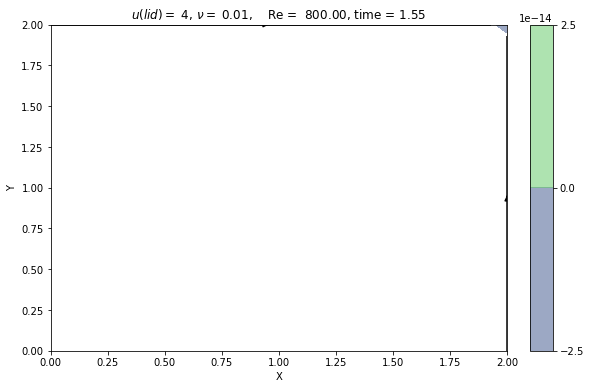

In [91]:

### Animation ###

cavity_flow = CFD()

u_lid = 4
Re = np.array([200, 400, 600, 800])
nus = 2*u_lid / Re

cavity_flow.initialize(u_lid = u_lid, nu = nus[3], system = 'two_lid_cavity')

# create figure, axis, and lines for drawing
#lines  = [None, None]
fig    = plt.figure(figsize =(9,6))
ax     = plt.subplot(xlim = (cavity_flow.x_min, cavity_flow.x_max), 
                     ylim = (cavity_flow.y_min, cavity_flow.y_max))

# colorbar axis
div = make_axes_locatable(ax)
cax = div.append_axes('right', '5%', '5%')

# initialize lines to certain values
cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
cb = fig.colorbar(cf, cax=cax, label = 'Pressure. p')

# plotting streamplot
stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

ax.set_xlabel('X')
ax.set_ylabel('Y');
ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu}, time = {cavity_flow.time:0.2f}')


def animate(i):
    cavity_flow.update_cavity_flow(nt=50)

    ax.collections = [] # clear lines streamplot
    ax.patches = [] # clear arrowheads streamplot
    
    cf = ax.contourf(cavity_flow.X, cavity_flow.Y, cavity_flow.p, alpha=0.5)
    cax.cla()
    fig.colorbar(cf, cax=cax)

    # plotting streamplot
    stream = ax.streamplot(cavity_flow.X, cavity_flow.Y, cavity_flow.u, cavity_flow.v, color = 'black')  

    ax.set_title(f'$u (lid) =$ {cavity_flow.u_lid}, $\\nu =$ {cavity_flow.nu:0.2f},\
    Re = {cavity_flow.u_lid*2/cavity_flow.nu: 0.2f}, time = {cavity_flow.time:0.2f}')
    return [cf, stream]
    
    
# starts animation
ani = animation.FuncAnimation(fig, animate, np.arange(1, 30), interval = 150)
HTML(ani.to_html5_video())


Now for two-lid system, we can find two separate region where the fluid is moving. Similar to one-lid cases, here also for high Re value, the system takes more time to stable and generally it is more turbulant. 

As the Re values increases, we can see that some low pressure regions are generated around the central vortices. And as the Re increases further (i.e. for Re=800) the fluid flow becomes very unstable and the separatio between the two separate fluid flow regions breaks. 